In [1]:
import os
import time
import tensorflow as tf
import numpy as np
import pandas as pd
from PIL import Image, ImageFont, ImageDraw
from PIL import ImageFile
ImageFile.LOAD_TRUNCATED_IMAGES = True
import colorsys

%cd kerasyolo3master


# 將 yolo.py 所需要的套件載入
from timeit import default_timer as timer

from yolo3.model import preprocess_true_boxes, yolo_body, tiny_yolo_body, yolo_loss
from yolo3.utils import get_random_data

from keras import backend as K
from keras.models import load_model,Model
from keras.layers import Input,Lambda
from keras.optimizers import Adam
from keras.callbacks import TensorBoard, ModelCheckpoint, ReduceLROnPlateau, EarlyStopping

from train import get_classes, get_anchors, create_model, create_tiny_model
from yolo import YOLO
from yolo3.model import yolo_eval, yolo_body, tiny_yolo_body
from yolo3.utils import letterbox_image

from keras.utils import multi_gpu_model


C:\Users\a2541\anaconda3\lib\site-packages\tensorflow\python\framework\dtypes.py:516: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint8 = np.dtype([("qint8", np.int8, 1)])
C:\Users\a2541\anaconda3\lib\site-packages\tensorflow\python\framework\dtypes.py:517: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_quint8 = np.dtype([("quint8", np.uint8, 1)])
C:\Users\a2541\anaconda3\lib\site-packages\tensorflow\python\framework\dtypes.py:518: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint16 = np.dtype([("qint16", np.int16, 1)])
C:\Users\a2541\anaconda3\lib\site-packages\tensorflow\python\framework\dtypes.py:519: FutureWarning: Passi

C:\Users\a2541\Documents\github\2nd-DL-CVMarathon\homework\Final_Project\kerasyolo3master


C:\Users\a2541\anaconda3\lib\site-packages\tensorboard\compat\tensorflow_stub\dtypes.py:541: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint8 = np.dtype([("qint8", np.int8, 1)])
C:\Users\a2541\anaconda3\lib\site-packages\tensorboard\compat\tensorflow_stub\dtypes.py:542: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_quint8 = np.dtype([("quint8", np.uint8, 1)])
C:\Users\a2541\anaconda3\lib\site-packages\tensorboard\compat\tensorflow_stub\dtypes.py:543: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint16 = np.dtype([("qint16", np.int16, 1)])
C:\Users\a2541\anaconda3\lib\site-packages\tensorboard\compat\tensorflow_stub\dtypes.

### 分割數據集

訓練集:Train         70%

開發集:Validation    20%

測試集:Test          10%

In [2]:
if not os.path.exists('animals_train.txt'):
    import xml.etree.ElementTree as ElementTree # 載入能夠 Parser xml 文件的 library
    
    sets = ['train', 'validation' ,'test']
    classes = ["raccoon", "kangaroo"]
    
    def dump_info(xml_path, list_file):
        f = open(xml_path)
        tree = ElementTree.parse(f)
        root = tree.getroot()
        
        for obj in tree.iter('object'):
            diff = int(obj.find('difficult').text)
            cls_name = obj.find('name').text
            if cls_name not in classes or diff == 1:
                continue
                
            cls_index = classes.index(cls_name)
            bndbox = obj.find('bndbox')

            b = (int(bndbox.find('xmin').text), int(bndbox.find('ymin').text), int(bndbox.find('xmax').text), int(bndbox.find('ymax').text))
            list_file.write(" " + ",".join([str(a) for a in b]) + ',' + str(cls_index))
    
        f.close()

    images_dir = ['Data/raccoon/images', 'Data/kangaroo/images']
    for s in sets:
        list_file = open('animals_%s.txt' % s, 'w')
        
        for i, annotation_path in enumerate(['Data/raccoon/annotations', 'Data/kangaroo/annotations']):
            annots = os.listdir(annotation_path)
            annots.sort()
            annot_size = len(annots)
            train_num = int(np.round(annot_size * 0.7))
            val_num = int(np.round(annot_size * 0.2))
            
            if s == 'train':
                data = annots[:train_num]
            elif s=='validation':
                data = annots[train_num:train_num+val_num]
            else:
                data = annots[train_num+val_num:]
                
            for d in data:
                name = d.split('.')[0]
                list_file.write(os.path.join(images_dir[i], '%s.jpg' % name))
                dump_info(os.path.join(annotation_path, d), list_file)
                list_file.write('\n')
        
        list_file.close()

In [3]:
with open('animals_train.txt') as f:
    train_lines = f.readlines()
with open('animals_validation.txt') as f:
    val_lines = f.readlines()
with open('animals_test.txt') as f:
    test_lines = f.readlines()

## 觀察訓練資料

### 浣熊

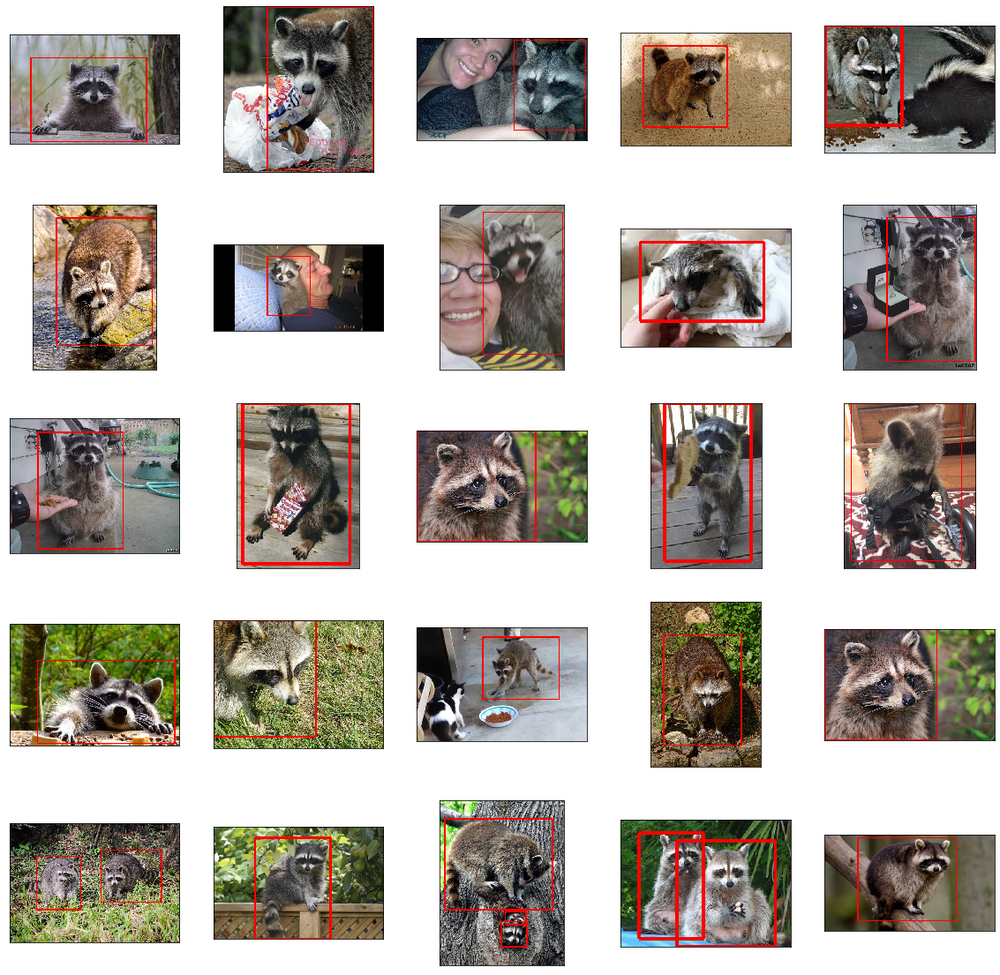

In [4]:
import matplotlib.pyplot as plt
fig = plt.figure(figsize=(20,20))
for i in range(25):
    line = train_lines[i].split()
    image = Image.open(line[0])
    boxs = np.array([np.array(list(map(int,boxs.split(',')))) for boxs in line[1:]])
    draw = ImageDraw.Draw(image)
    for box in boxs:
        top, left, bottom, right,label = box
        draw.line(((top,left),(top,right),(bottom,right),(bottom,left),(top,left)), fill="red", width=5)
    ax = fig.add_subplot(5, 5, i + 1, xticks=[], yticks=[])
    plt.imshow(image)

### 袋鼠

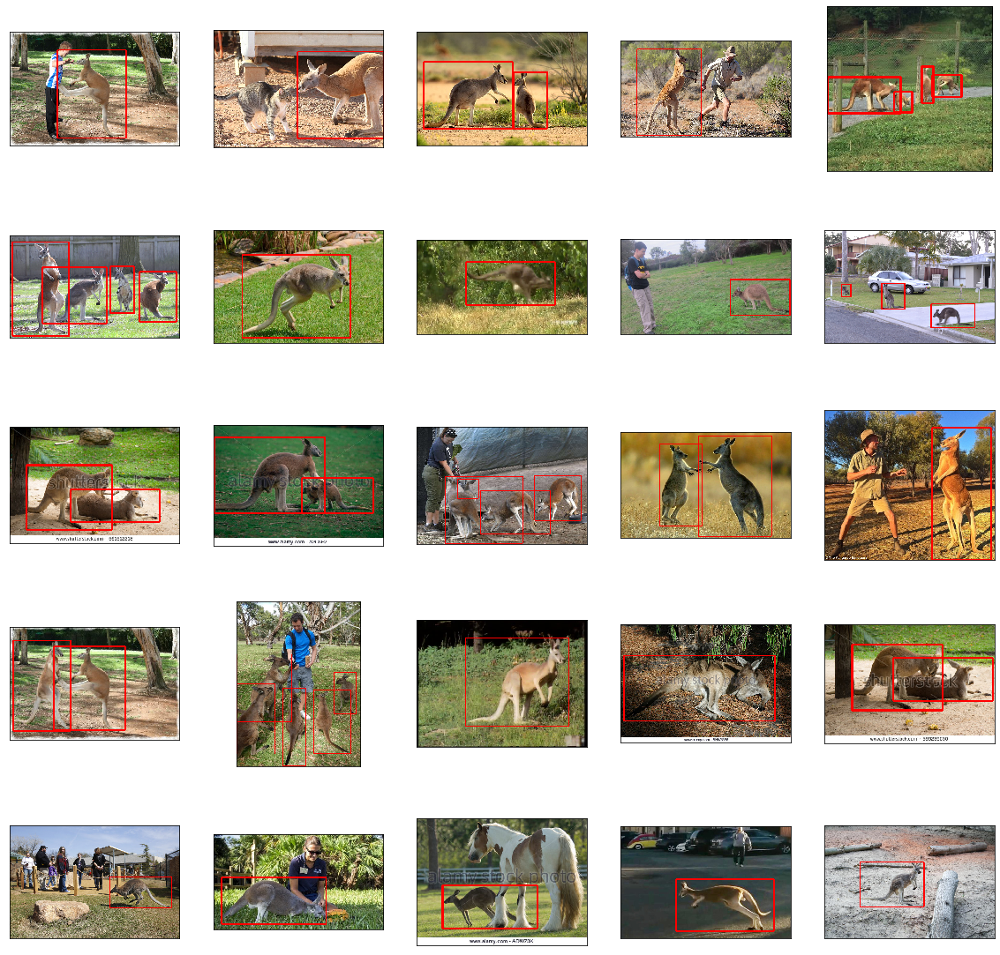

In [5]:
fig = plt.figure(figsize=(20,20))
for i in range(len(train_lines)-25,len(train_lines)):
    line = train_lines[i].split()
    image = Image.open(line[0])
    boxs = np.array([np.array(list(map(int,boxs.split(',')))) for boxs in line[1:]])
    draw = ImageDraw.Draw(image)
    for box in boxs:
        top, left, bottom, right,label = box
        draw.line(((top,left),(top,right),(bottom,right),(bottom,left),(top,left)), fill="red", width=5)
    ax = fig.add_subplot(5, 5, i + 1 - (len(train_lines)-25), xticks=[], yticks=[])
    plt.imshow(image)

## 水平翻轉圖片

In [6]:
def augment_data(img, boxs):
    img = np.asarray(img)
    rows, cols = img.shape[0:2]

    # np.copy(img)複製圖片
    new_img = np.copy(img)

    # 翻轉圖片
    for i in range(rows):
        for j in range(cols):
            temp = img[i][j]
            new_img[i][j] = img[i][cols-j-1]
            new_img[i][cols-j-1] = temp
    new_boxs = []
    # 翻轉boxs
    for box in boxs:
        top, left, bottom, right,label = box
        top = cols - top
        bottom = cols - bottom
        
        new_boxs.append([top,left,bottom,right,label])
    new_boxs = np.array(new_boxs) 
    return Image.fromarray(np.uint8(new_img)),new_boxs

### 水平翻轉浣熊

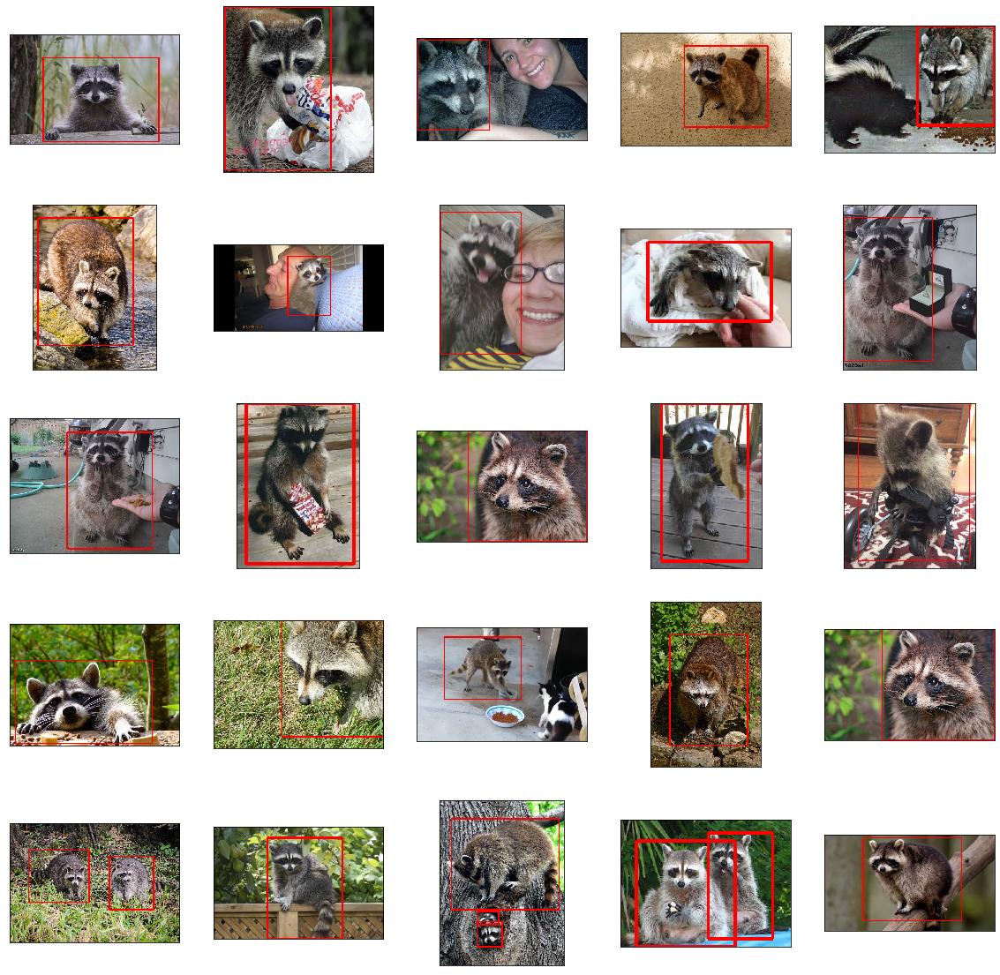

In [7]:
fig = plt.figure(figsize=(20,20))
for i in range(25):
    line = train_lines[i].split()
    image = Image.open(line[0])
    boxs = np.array([np.array(list(map(int,boxs.split(',')))) for boxs in line[1:]])
    image,boxs = augment_data(image,boxs)
    draw = ImageDraw.Draw(image)
    for box in boxs:
        top, left, bottom, right,label = box
        draw.line(((top,left),(top,right),(bottom,right),(bottom,left),(top,left)), fill="red", width=5)
    ax = fig.add_subplot(5, 5, i + 1, xticks=[], yticks=[])
    plt.imshow(image)

### 水平翻轉袋鼠

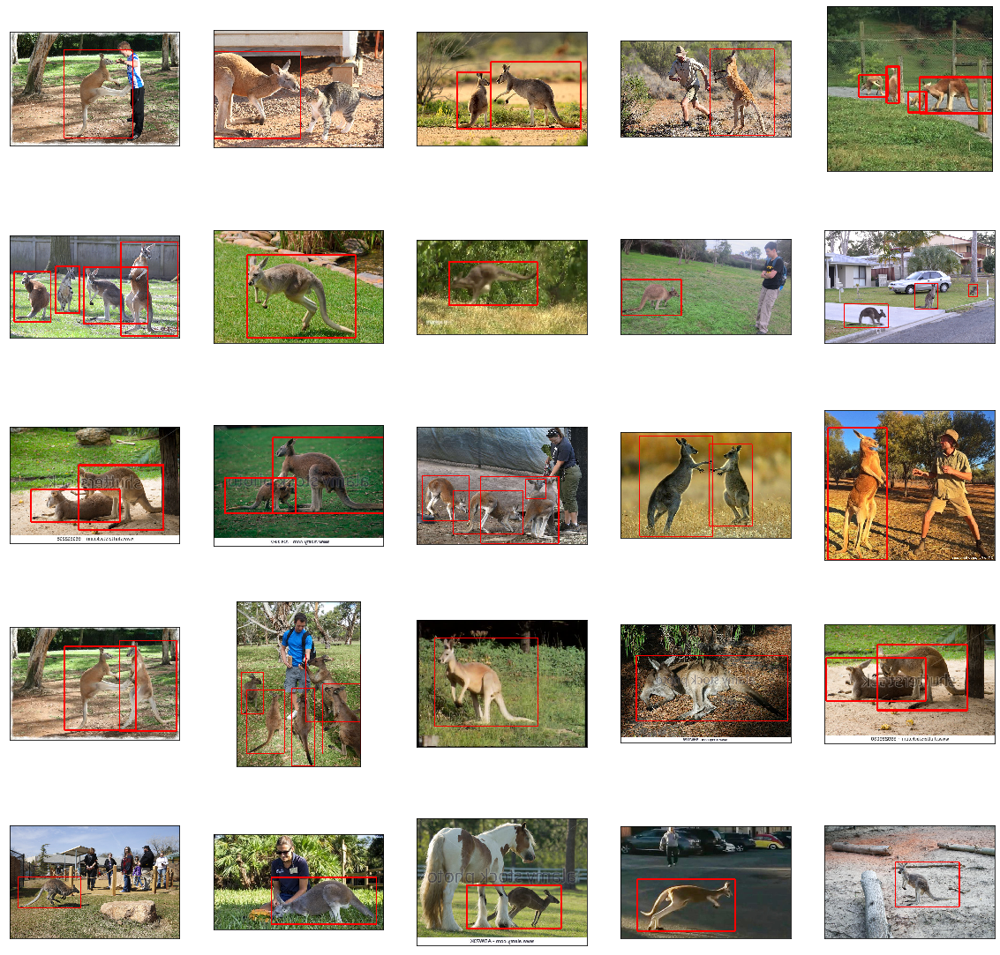

In [8]:
fig = plt.figure(figsize=(20,20))
for i in range(len(train_lines)-25,len(train_lines)):
    line = train_lines[i].split()
    image = Image.open(line[0])
    boxs = np.array([np.array(list(map(int,boxs.split(',')))) for boxs in line[1:]])
    image,boxs = augment_data(image,boxs)
    draw = ImageDraw.Draw(image)
    for box in boxs:
        top, left, bottom, right,label = box
        draw.line(((top,left),(top,right),(bottom,right),(bottom,left),(top,left)), fill="red", width=5)
    ax = fig.add_subplot(5, 5, i + 1 - (len(train_lines)-25), xticks=[], yticks=[])
    plt.imshow(image)

### 輸出水平翻轉資料

In [9]:
file = open('animals_augment_train.txt', 'w')
for i in range(len(train_lines)):
    file.write(train_lines[i])
    line = train_lines[i].split()
    image = Image.open(line[0])
    boxs = np.array([np.array(list(map(int,boxs.split(',')))) for boxs in line[1:]])
    image,boxs = augment_data(image,boxs)
    image.save(line[0].split('\\')[0].split('images')[0]+'augment_images/'+line[0].split('\\')[1].split('.')[0]+'_augment.jpg')
    file.write(line[0].split('\\')[0].split('images')[0]+'augment_images/'+line[0].split('\\')[1].split('.')[0]+'_augment.jpg')
    for box in boxs:
        file.write(' ')
        for index in range(4):
            file.write(str(box[index]))
            file.write(',')
        file.write(str(box[4]))
    file.write('\n')
file.close()

file = open('animals_augment_val.txt', 'w')
for i in range(len(val_lines)):
    file.write(val_lines[i])
    line = val_lines[i].split()
    image = Image.open(line[0])
    boxs = np.array([np.array(list(map(int,boxs.split(',')))) for boxs in line[1:]])
    image,boxs = augment_data(image,boxs)
    image.save(line[0].split('\\')[0].split('images')[0]+'augment_images/'+line[0].split('\\')[1].split('.')[0]+'_augment.jpg')
    file.write(line[0].split('\\')[0].split('images')[0]+'augment_images/'+line[0].split('\\')[1].split('.')[0]+'_augment.jpg')
    for box in boxs:
        file.write(' ')
        for index in range(4):
            file.write(str(box[index]))
            file.write(',')
        file.write(str(box[4]))
    file.write('\n')
file.close()

file = open('animals_augment_test.txt', 'w')
for i in range(len(test_lines)):
    file.write(test_lines[i])
    line = test_lines[i].split()
    image = Image.open(line[0])
    boxs = np.array([np.array(list(map(int,boxs.split(',')))) for boxs in line[1:]])
    image,boxs = augment_data(image,boxs)
    image.save(line[0].split('\\')[0].split('images')[0]+'augment_images/'+line[0].split('\\')[1].split('.')[0]+'_augment.jpg')
    file.write(line[0].split('\\')[0].split('images')[0]+'augment_images/'+line[0].split('\\')[1].split('.')[0]+'_augment.jpg')
    for box in boxs:
        file.write(' ')
        for index in range(4):
            file.write(str(box[index]))
            file.write(',')
        file.write(str(box[4]))
    file.write('\n')
file.close()

In [10]:
with open('animals_train.txt') as f:
    train_lines = f.readlines()
with open('animals_validation.txt') as f:
    val_lines = f.readlines()
with open('animals_test.txt') as f:
    test_lines = f.readlines()
    np.random.shuffle(test_lines)
num_train = len(train_lines)
num_val = len(val_lines)
num_test = len(test_lines)

with open('animals_augment_train.txt') as f:
    train_aug_lines = f.readlines()
with open('animals_augment_val.txt') as f:
    val_aug_lines = f.readlines()
with open('animals_augment_test.txt') as f:
    test_aug_lines = f.readlines()
num_aug_train = len(train_aug_lines)
num_aug_val = len(val_aug_lines)
num_aug_test = len(test_aug_lines)

## 載入 yolov3-tiny初始化網路參數

In [12]:
if not os.path.exists('model_data/yolov3-tiny.h5'):
    os.system('python convert.py yolov3-tiny.cfg yolov3-tiny.weights model_data/yolov3-tiny.h5')

In [13]:
annotation_path = 'animals_train.txt' # 轉換好格式的標註檔案
log_dir = 'logs/%s/' % str(int(time.time()))# 訓練好的模型儲存的路徑
classes_path = 'model_data/classes.txt'
anchors_path = 'model_data/tiny_yolo_anchors.txt'
class_names = get_classes(classes_path)
num_classes = len(class_names)
anchors = get_anchors(anchors_path)
input_shape = (416,416) 
tiny_model = create_tiny_model(input_shape, anchors, num_classes,  freeze_body=2, weights_path='model_data/yolov3-tiny.h5')
logging = TensorBoard(log_dir=log_dir)
checkpoint = ModelCheckpoint(log_dir + 'ep{epoch:03d}-loss{loss:.3f}-val_loss{val_loss:.3f}.h5',
    monitor='val_loss', save_weights_only=True, save_best_only=True, period=3)
reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.1, patience=10, verbose=1)
early_stopping = EarlyStopping(monitor='val_loss', min_delta=0, patience=30, verbose=1)


Create Tiny YOLOv3 model with 6 anchors and 2 classes.


C:\Users\a2541\anaconda3\lib\site-packages\keras\engine\saving.py:1319: UserWarning: Skipping loading of weights for layer conv2d_10 due to mismatch in shape ((1, 1, 512, 21) vs (255, 512, 1, 1)).
  weight_values[i].shape))
C:\Users\a2541\anaconda3\lib\site-packages\keras\engine\saving.py:1319: UserWarning: Skipping loading of weights for layer conv2d_10 due to mismatch in shape ((21,) vs (255,)).
  weight_values[i].shape))
C:\Users\a2541\anaconda3\lib\site-packages\keras\engine\saving.py:1319: UserWarning: Skipping loading of weights for layer conv2d_13 due to mismatch in shape ((1, 1, 256, 21) vs (255, 256, 1, 1)).
  weight_values[i].shape))
C:\Users\a2541\anaconda3\lib\site-packages\keras\engine\saving.py:1319: UserWarning: Skipping loading of weights for layer conv2d_13 due to mismatch in shape ((21,) vs (255,)).
  weight_values[i].shape))


Load weights model_data/yolov3-tiny.h5.
Freeze the first 42 layers of total 44 layers.
Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where


## 訓練網路

 原始資料訓練

第一階段訓練只訓練輸出層

In [11]:
def data_generator(annotation_lines, batch_size, input_shape, anchors, num_classes, is_train=True):
    '''data generator for fit_generator'''
    n = len(annotation_lines)
    i = 0
    while True:
        image_data = []
        box_data = []
        for b in range(batch_size):
            if i==0 and is_train:
                np.random.shuffle(annotation_lines)
            image, box = get_random_data(annotation_lines[i], input_shape, random=is_train)
            image_data.append(image)
            box_data.append(box)
            i = (i+1) % n
        image_data = np.array(image_data)
        box_data = np.array(box_data)
        y_true = preprocess_true_boxes(box_data, input_shape, anchors, num_classes)
        yield [image_data, *y_true], np.zeros(batch_size)

In [14]:
# Train with frozen layers first, to get a stable loss.
# Adjust num epochs to your dataset. This step is enough to obtain a not bad model.
# 一開始先 freeze YOLO 除了 output layer 以外的 darknet53 backbone 來 train
if True:
    tiny_model.compile(optimizer=Adam(lr=1e-3), loss={
        # use custom yolo_loss Lambda layer.
        'yolo_loss': lambda y_true, y_pred: y_pred})

    batch_size = 17
    print('Train on {} samples, val on {} samples, with batch size {}.'.format(num_train, num_val, batch_size))
    # 模型利用 generator 產生的資料做訓練，強烈建議大家去閱讀及理解 data_generator_wrapper 在 train.py 中的實現
    history_original = tiny_model.fit_generator(data_generator(train_lines, batch_size, input_shape, anchors, num_classes, True),
            steps_per_epoch=max(1, num_train//batch_size),
            validation_data=data_generator(val_lines, batch_size, input_shape, anchors, num_classes, False),
            validation_steps=max(1, num_val//batch_size),
            epochs=100,
            initial_epoch=0,
            callbacks=[logging, checkpoint, reduce_lr, early_stopping])
    tiny_model.save_weights(log_dir + 'trained_weights_stage_1.h5')

Train on 255 samples, val on 73 samples, with batch size 17.



Epoch 1/100
15/15 [==============================] - 23s 2s/step - loss: 955.9126 - val_loss: 315.9911

Epoch 2/100
15/15 [==============================] - 22s 1s/step - loss: 245.3199 - val_loss: 119.9481
Epoch 3/100
15/15 [==============================] - 25s 2s/step - loss: 108.4872 - val_loss: 70.2559
Epoch 4/100
15/15 [==============================] - 21s 1s/step - loss: 71.3771 - val_loss: 57.7315
Epoch 5/100
15/15 [==============================] - 23s 2s/step - loss: 57.5921 - val_loss: 49.7623
Epoch 6/100
15/15 [==============================] - 23s 2s/step - loss: 49.2147 - val_loss: 38.3442
Epoch 7/100
15/15 [==============================] - 22s 1s/step - loss: 43.1156 - val_loss: 33.6848
Epoch 8/100
15/15 [==============================] - 23s 2s/step - loss: 39.5144 - val_loss: 31.2046
Epoch 9/100
15/15 [==============================] - 24s 2s/step - loss: 36.6689 - val_loss: 31.6870
Epoch 10/100
15/15 [=

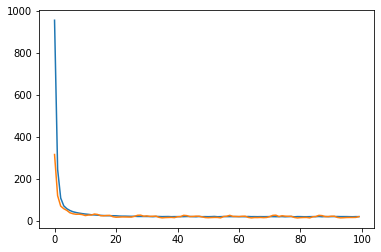

In [15]:
plt.plot(history_original.epoch, history_original.history['loss'], history_original.epoch, history_original.history['val_loss'])

第二階段訓練 對整個網路訓練

In [16]:
# Unfreeze and continue training, to fine-tune.
# Train longer if the result is not good.
if True:
    # 把所有 layer 都改為 trainable
    for i in range(len(tiny_model.layers)):
        tiny_model.layers[i].trainable = True
    tiny_model.compile(optimizer=Adam(lr=1e-4), loss={'yolo_loss': lambda y_true, y_pred: y_pred}) # recompile to apply the change
    print('Unfreeze all of the layers.')

    batch_size = 17 # note that more GPU memory is required after unfreezing the body
    print('Train on {} samples, val on {} samples, with batch size {}.'.format(num_train, num_val, batch_size))
    history2_original = tiny_model.fit_generator(data_generator(train_lines, batch_size, input_shape, anchors, num_classes, True),
        steps_per_epoch=max(1, num_train//batch_size),
        validation_data=data_generator(val_lines, batch_size, input_shape, anchors, num_classes, False),
        validation_steps=max(1, num_val//batch_size),
        epochs=500,
        initial_epoch=50,
        callbacks=[logging, checkpoint, reduce_lr, early_stopping])
    tiny_model.save_weights(log_dir + 'trained_weights_final.h5')

Unfreeze all of the layers.
Train on 255 samples, val on 73 samples, with batch size 17.
Epoch 51/500
15/15 [==============================] - 22s 1s/step - loss: 17.5859 - val_loss: 18.7975
Epoch 52/500
15/15 [==============================] - 19s 1s/step - loss: 16.1486 - val_loss: 20.9513
Epoch 53/500
15/15 [==============================] - 21s 1s/step - loss: 15.5177 - val_loss: 18.1563
Epoch 54/500
15/15 [==============================] - 20s 1s/step - loss: 14.6989 - val_loss: 17.0393
Epoch 55/500
15/15 [==============================] - 21s 1s/step - loss: 14.2862 - val_loss: 16.5784
Epoch 56/500
15/15 [==============================] - 21s 1s/step - loss: 14.2220 - val_loss: 12.1987
Epoch 57/500
15/15 [==============================] - 20s 1s/step - loss: 14.5822 - val_loss: 10.5011
Epoch 58/500
15/15 [==============================] - 21s 1s/step - loss: 13.9783 - val_loss: 11.8192
Epoch 59/500
15/15 [==============================] - 20s 1s/step - loss: 13.7297 - val_loss: 1

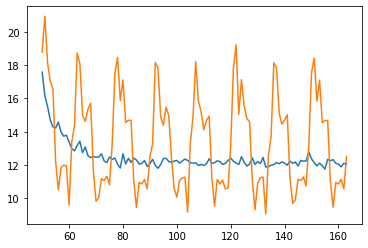

In [17]:
plt.plot(history2_original.epoch, history2_original.history['loss'], history2_original.epoch, history2_original.history['val_loss'])

In [18]:
# 定義 YOLO class
class YOLO(object):
    _defaults = {
        "model_path": 'model_data/yolo.h5',
        "anchors_path": 'model_data/yolo_anchors.txt',
        "classes_path": 'model_data/coco_classes.txt',
        "score" : 0.3,
        "iou" : 0.45,
        "model_image_size" : (416, 416),
        "gpu_num" : 1,
    }

    @classmethod
    def get_defaults(cls, n):
        if n in cls._defaults:
            return cls._defaults[n]
        else:
            return "Unrecognized attribute name '" + n + "'"

    def __init__(self, **kwargs):
        self.__dict__.update(self._defaults) # set up default values
        self.__dict__.update(kwargs) # and update with user overrides
        self.class_names = self._get_class()
        self.anchors = self._get_anchors()
        self.sess = K.get_session()
        self.boxes, self.scores, self.classes = self.generate()

    def _get_class(self):
        classes_path = os.path.expanduser(self.classes_path)
        with open(classes_path) as f:
            class_names = f.readlines()
        class_names = [c.strip() for c in class_names]
        return class_names

    def _get_anchors(self):
        anchors_path = os.path.expanduser(self.anchors_path)
        with open(anchors_path) as f:
            anchors = f.readline()
        anchors = [float(x) for x in anchors.split(',')]
        return np.array(anchors).reshape(-1, 2)

    def generate(self):
        model_path = os.path.expanduser(self.model_path)
        assert model_path.endswith('.h5'), 'Keras model or weights must be a .h5 file.'

        # Load model, or construct model and load weights.
        num_anchors = len(self.anchors)
        num_classes = len(self.class_names)
        is_tiny_version = num_anchors==6 # default setting
        try:
            self.yolo_model = load_model(model_path, compile=False)
        except:
            self.yolo_model = tiny_yolo_body(Input(shape=(None,None,3)), num_anchors//2, num_classes) \
                if is_tiny_version else yolo_body(Input(shape=(None,None,3)), num_anchors//3, num_classes)
            self.yolo_model.load_weights(self.model_path) # make sure model, anchors and classes match
        else:
            assert self.yolo_model.layers[-1].output_shape[-1] == \
                num_anchors/len(self.yolo_model.output) * (num_classes + 5), \
                'Mismatch between model and given anchor and class sizes'

        print('{} model, anchors, and classes loaded.'.format(model_path))

        # Generate colors for drawing bounding boxes.
        hsv_tuples = [(x / len(self.class_names), 1., 1.)
                      for x in range(len(self.class_names))]
        self.colors = list(map(lambda x: colorsys.hsv_to_rgb(*x), hsv_tuples))
        self.colors = list(
            map(lambda x: (int(x[0] * 255), int(x[1] * 255), int(x[2] * 255)),
                self.colors))
        np.random.seed(10101)  # Fixed seed for consistent colors across runs.
        np.random.shuffle(self.colors)  # Shuffle colors to decorrelate adjacent classes.
        np.random.seed(None)  # Reset seed to default.

        # Generate output tensor targets for filtered bounding boxes.
        self.input_image_shape = K.placeholder(shape=(2, ))
        if self.gpu_num>=2:
            self.yolo_model = multi_gpu_model(self.yolo_model, gpus=self.gpu_num)
        boxes, scores, classes = yolo_eval(self.yolo_model.output, self.anchors,
                len(self.class_names), self.input_image_shape,
                score_threshold=self.score, iou_threshold=self.iou)
        return boxes, scores, classes

    # 更改 detect_image 使得其回傳需要的信息
    def detect_image(self, image):
        start = timer()

        if self.model_image_size != (None, None):
            assert self.model_image_size[0]%32 == 0, 'Multiples of 32 required'
            assert self.model_image_size[1]%32 == 0, 'Multiples of 32 required'
            boxed_image = letterbox_image(image, tuple(reversed(self.model_image_size)))
        else:
            new_image_size = (image.width - (image.width % 32),
                              image.height - (image.height % 32))
            boxed_image = letterbox_image(image, new_image_size)
        image_data = np.array(boxed_image, dtype='float32')

        print(image_data.shape)
        image_data /= 255.
        image_data = np.expand_dims(image_data, 0)  # Add batch dimension.

        out_boxes, out_scores, out_classes = self.sess.run(
            [self.boxes, self.scores, self.classes],
            feed_dict={
                self.yolo_model.input: image_data,
                self.input_image_shape: [image.size[1], image.size[0]],
                K.learning_phase(): 0
            })

        print('Found {} boxes for {}'.format(len(out_boxes), 'img'))

        font = ImageFont.truetype(font='font/FiraMono-Medium.otf',
                    size=np.floor(3e-2 * image.size[1] + 0.5).astype('int32'))
        thickness = (image.size[0] + image.size[1]) // 300

        for i, c in reversed(list(enumerate(out_classes))):
            predicted_class = self.class_names[c]
            box = out_boxes[i]
            score = out_scores[i]

            label = '{} {:.2f}'.format(predicted_class, score)
            draw = ImageDraw.Draw(image)
            label_size = draw.textsize(label, font)

            top, left, bottom, right = box
            top = max(0, np.floor(top + 0.5).astype('int32'))
            left = max(0, np.floor(left + 0.5).astype('int32'))
            bottom = min(image.size[1], np.floor(bottom + 0.5).astype('int32'))
            right = min(image.size[0], np.floor(right + 0.5).astype('int32'))
            print(label, (left, top), (right, bottom))

            if top - label_size[1] >= 0:
                text_origin = np.array([left, top - label_size[1]])
            else:
                text_origin = np.array([left, top + 1])

            # My kingdom for a good redistributable image drawing library.
            for i in range(thickness):
                draw.rectangle(
                    [left + i, top + i, right - i, bottom - i],
                    outline=self.colors[c])
            draw.rectangle(
                [tuple(text_origin), tuple(text_origin + label_size)],
                fill=self.colors[c])
            draw.text(text_origin, label, fill=(0, 0, 0), font=font)
            del draw

        end = timer()
        #print(end - start)
        return image,out_boxes, out_scores, out_classes # Hint: 在這裡更改程式碼即可

    def close_session(self):
        self.sess.close()

In [19]:
config_dict = {
    'model_path': log_dir + 'trained_weights_final.h5', 
    'anchors_path': anchors_path,
    'classes_path':classes_path
    }
tiny_yolo = YOLO(**config_dict)

logs/1588706021/trained_weights_final.h5 model, anchors, and classes loaded.


## 定義IOU計算函數

In [20]:
def compute_iou(boxA, boxB):
    boxA = [int(x) for x in boxA]
    boxB = [int(x) for x in boxB]

    xA = max(boxA[0], boxB[0])
    yA = max(boxA[1], boxB[1])
    xB = min(boxA[2], boxB[2])
    yB = min(boxA[3], boxB[3])

    interArea = max(0, xB - xA + 1) * max(0, yB - yA + 1)

    boxAArea = (boxA[2] - boxA[0] + 1) * (boxA[3] - boxA[1] + 1)
    boxBArea = (boxB[2] - boxB[0] + 1) * (boxB[3] - boxB[1] + 1)
    
    iou = interArea / float(boxAArea + boxBArea - interArea)

    return iou

### 訓練集結果

(416, 416, 3)
Found 1 boxes for img
kangaroo 0.45 (578, 279) (808, 460)
IOU : 0
(416, 416, 3)
Found 2 boxes for img
raccoon 0.42 (145, 80) (203, 138)
raccoon 0.80 (70, 65) (167, 132)
IOU : 0
IOU : 0.5415245292254975
(416, 416, 3)
Found 1 boxes for img
raccoon 0.71 (15, 0) (206, 193)
IOU : 13.05704201297962
(416, 416, 3)
Found 1 boxes for img
raccoon 0.50 (69, 18) (439, 479)
IOU : 29.367166950332663
(416, 416, 3)
Found 1 boxes for img
kangaroo 0.49 (273, 209) (640, 393)
IOU : 7.634019730853446
(416, 416, 3)
Found 1 boxes for img
raccoon 0.43 (57, 25) (545, 373)
IOU : 31.096073648595485
(416, 416, 3)
Found 1 boxes for img
raccoon 0.85 (104, 27) (189, 101)
IOU : 0
(416, 416, 3)
Found 2 boxes for img
raccoon 0.39 (29, 0) (159, 183)
raccoon 0.48 (137, 23) (271, 146)
IOU : 2.290036785658774
IOU : 9.191398220066716
(416, 416, 3)
Found 1 boxes for img
kangaroo 0.42 (172, 171) (351, 363)
IOU : 36.82072117826308


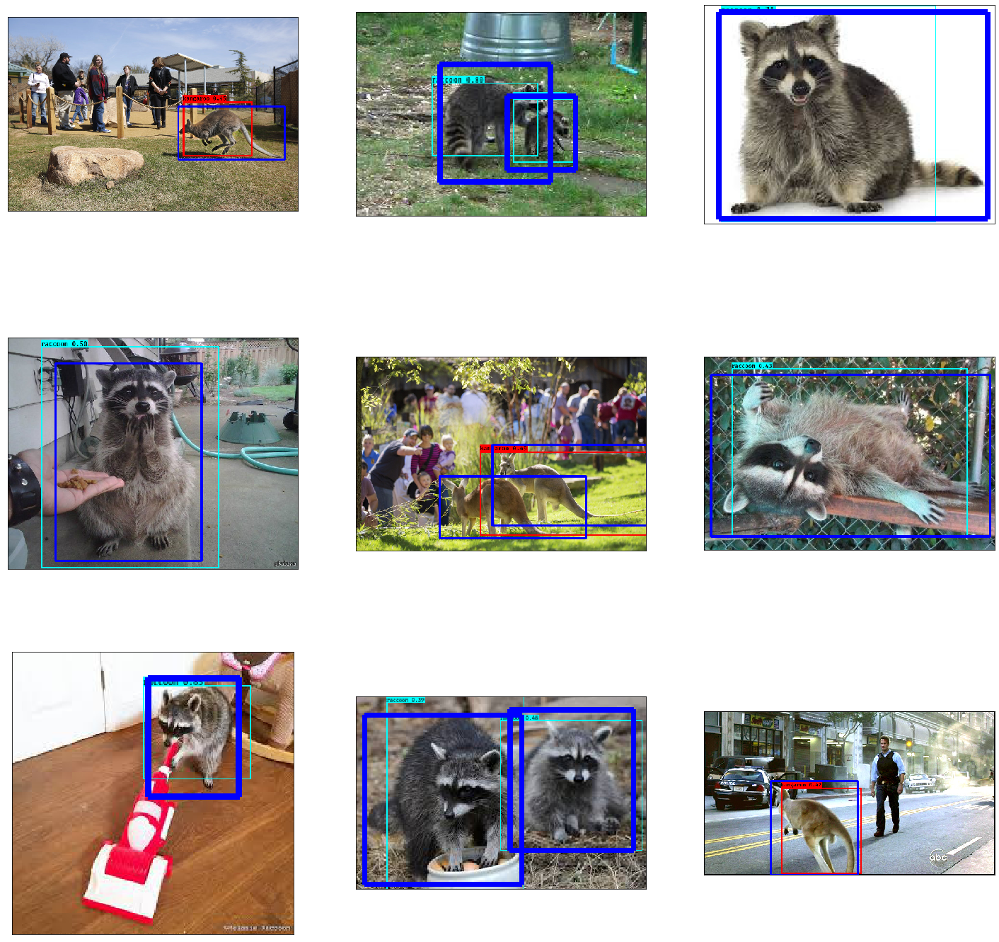

In [21]:
fig = plt.figure(figsize=(25,25))
for i in range(9):
    line = train_lines[i].split()
    image = Image.open(line[0])
    image = image.convert('RGB')
    tiny_yolo_image,out_boxes,out_scores,out_classes = tiny_yolo.detect_image(image)
    boxs = np.array([np.array(list(map(int,boxs.split(',')))) for boxs in line[1:]])
    draw = ImageDraw.Draw(tiny_yolo_image)
    for box in boxs:
        top, left, bottom, right,label = box
        draw.line(((top,left),(top,right),(bottom,right),(bottom,left),(top,left)), fill="blue", width=5)
    ax = fig.add_subplot(3, 3, i + 1, xticks=[], yticks=[])
    plt.imshow(tiny_yolo_image)
    for box in out_boxes:
        max_iou = 0
        for ground_truth in test_lines[0].split()[1:]:
            ground_truth = [int(i) for i in ground_truth.split(',')]
            iou = compute_iou(ground_truth[:-1],box)
            if(max_iou<iou):
                max_iou = iou
        print("IOU :" , max_iou*100)

### 開發集結果

(416, 416, 3)
Found 1 boxes for img
raccoon 0.60 (106, 54) (497, 302)
IOU : 36.96474737617066
(416, 416, 3)
Found 1 boxes for img
raccoon 0.95 (148, 0) (434, 318)
IOU : 32.72082717872969
(416, 416, 3)
Found 1 boxes for img
raccoon 0.59 (41, 13) (223, 177)
IOU : 9.740259740259742
(416, 416, 3)
Found 1 boxes for img
raccoon 0.43 (34, 56) (227, 150)
IOU : 4.262303556658396
(416, 416, 3)
Found 1 boxes for img
raccoon 0.54 (124, 0) (607, 395)
IOU : 17.27005162680734
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 1 boxes for img
raccoon 0.64 (252, 123) (665, 491)
IOU : 10.16436783964913
(416, 416, 3)
Found 0 boxes for img


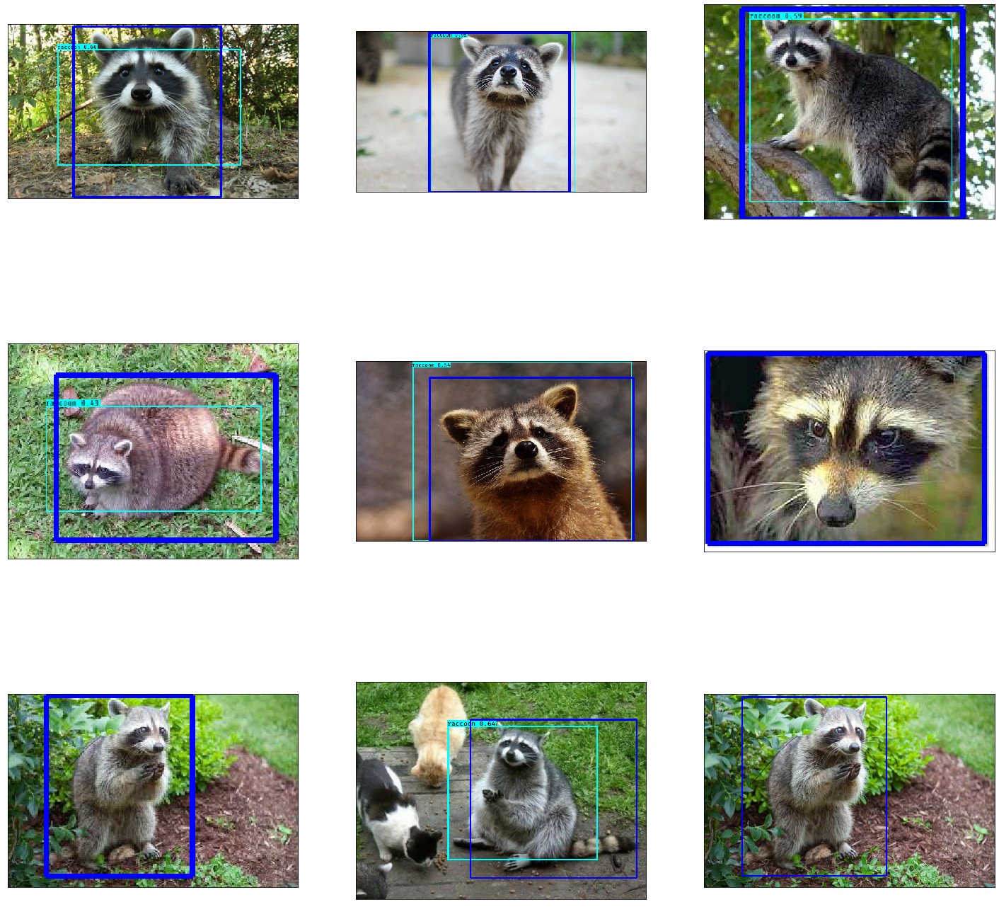

In [22]:
fig = plt.figure(figsize=(25,25))
for i in range(9):
    line = val_lines[i].split()
    image = Image.open(line[0])
    image = image.convert('RGB')
    tiny_yolo_image,out_boxes,out_scores,out_classes = tiny_yolo.detect_image(image)
    boxs = np.array([np.array(list(map(int,boxs.split(',')))) for boxs in line[1:]])
    draw = ImageDraw.Draw(tiny_yolo_image)
    for box in boxs:
        top, left, bottom, right,label = box
        draw.line(((top,left),(top,right),(bottom,right),(bottom,left),(top,left)), fill="blue", width=5)
    ax = fig.add_subplot(3, 3, i + 1, xticks=[], yticks=[])
    plt.imshow(tiny_yolo_image)
    for box in out_boxes:
        max_iou = 0
        for ground_truth in test_lines[0].split()[1:]:
            ground_truth = [int(i) for i in ground_truth.split(',')]
            iou = compute_iou(ground_truth[:-1],box)
            if(max_iou<iou):
                max_iou = iou
        print("IOU :" , max_iou*100)

### 測試集結果

(416, 416, 3)
Found 1 boxes for img
raccoon 0.67 (22, 17) (314, 411)
IOU : 55.55631445939485
(416, 416, 3)
Found 1 boxes for img
kangaroo 0.75 (311, 44) (528, 287)
IOU : 22.995422456887972
(416, 416, 3)
Found 1 boxes for img
raccoon 0.83 (19, 24) (243, 138)
IOU : 16.39244130559267
(416, 416, 3)
Found 1 boxes for img
raccoon 0.79 (116, 24) (547, 316)
IOU : 58.05104149215391
(416, 416, 3)
Found 1 boxes for img
kangaroo 0.46 (511, 240) (964, 612)
IOU : 0
(416, 416, 3)
Found 1 boxes for img
kangaroo 0.46 (162, 71) (507, 479)
IOU : 40.73864653718206
(416, 416, 3)
Found 1 boxes for img
raccoon 0.33 (7, 28) (191, 288)
IOU : 30.4383788254756
(416, 416, 3)
Found 1 boxes for img
kangaroo 0.38 (93, 83) (532, 396)
IOU : 51.71115533761464
(416, 416, 3)
Found 0 boxes for img


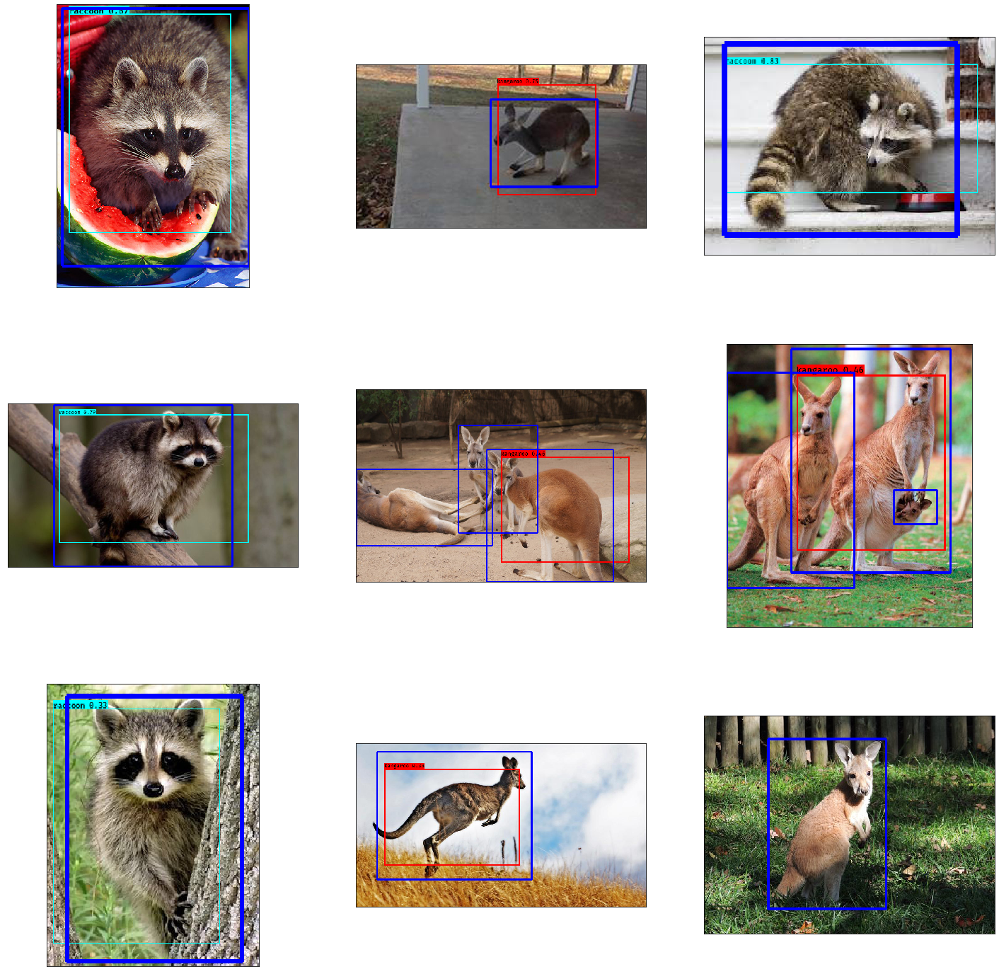

In [23]:
np.random.shuffle(test_lines)
fig = plt.figure(figsize=(25,25))
for i in range(9):
    line = test_lines[i].split()
    image = Image.open(line[0])
    image = image.convert('RGB')
    tiny_yolo_image,out_boxes,out_scores,out_classes = tiny_yolo.detect_image(image)
    boxs = np.array([np.array(list(map(int,boxs.split(',')))) for boxs in line[1:]])
    draw = ImageDraw.Draw(tiny_yolo_image)
    for box in boxs:
        top, left, bottom, right,label = box
        draw.line(((top,left),(top,right),(bottom,right),(bottom,left),(top,left)), fill="blue", width=5)
    ax = fig.add_subplot(3, 3, i + 1, xticks=[], yticks=[])
    plt.imshow(tiny_yolo_image)
    for box in out_boxes:
        max_iou = 0
        for ground_truth in test_lines[0].split()[1:]:
            ground_truth = [int(i) for i in ground_truth.split(',')]
            iou = compute_iou(ground_truth[:-1],box)
            if(max_iou<iou):
                max_iou = iou
        print("IOU :" , max_iou*100)    

## 增加水平翻轉資料訓練

In [24]:
# Train longer if the result is not good.
if True:
    batch_size = 17 # note that more GPU memory is required after unfreezing the body
    print('Train on {} samples, val on {} samples, with batch size {}.'.format(num_aug_train, num_aug_val, batch_size))
    history2_original = tiny_model.fit_generator(data_generator(train_aug_lines, batch_size, input_shape, anchors, num_classes, True),
        steps_per_epoch=max(1, num_aug_train//batch_size),
        validation_data=data_generator(val_aug_lines, batch_size, input_shape, anchors, num_classes, False),
        validation_steps=max(1, num_aug_val//batch_size),
        epochs=1000,
        initial_epoch=0,
        callbacks=[logging, checkpoint, reduce_lr, early_stopping])
    tiny_model.save_weights(log_dir + 'trained_weights_final.h5')

Train on 510 samples, val on 146 samples, with batch size 17.
Epoch 1/1000
30/30 [==============================] - 44s 1s/step - loss: 9.3548 - val_loss: 12.5826
Epoch 2/1000
30/30 [==============================] - 41s 1s/step - loss: 9.3717 - val_loss: 11.5923
Epoch 3/1000
30/30 [==============================] - 41s 1s/step - loss: 9.3165 - val_loss: 8.4869
Epoch 4/1000
30/30 [==============================] - 42s 1s/step - loss: 9.1705 - val_loss: 11.8007
Epoch 5/1000
30/30 [==============================] - 42s 1s/step - loss: 9.3099 - val_loss: 12.9988
Epoch 6/1000
30/30 [==============================] - 43s 1s/step - loss: 9.4445 - val_loss: 9.0389
Epoch 7/1000
30/30 [==============================] - 42s 1s/step - loss: 9.2327 - val_loss: 7.4982
Epoch 8/1000
30/30 [==============================] - 42s 1s/step - loss: 9.2768 - val_loss: 7.3648
Epoch 9/1000
30/30 [==============================] - 41s 1s/step - loss: 9.1852 - val_loss: 7.9161
Epoch 10/1000
30/30 [=============

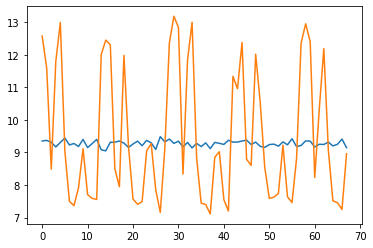

In [25]:
plt.plot(history2_original.epoch, history2_original.history['loss'], history2_original.epoch, history2_original.history['val_loss'])

In [26]:
config_dict = {
    'model_path': log_dir + 'trained_weights_final.h5', 
    'anchors_path': anchors_path,
    'classes_path':classes_path
    }
tiny_yolo = YOLO(**config_dict)

logs/1588706021/trained_weights_final.h5 model, anchors, and classes loaded.


### 訓練集辨識結果

(416, 416, 3)
Found 1 boxes for img
kangaroo 0.44 (576, 279) (809, 460)
IOU : 0
(416, 416, 3)
Found 2 boxes for img
raccoon 0.44 (145, 80) (203, 139)
raccoon 0.81 (70, 66) (167, 132)
IOU : 4.135013043201629
IOU : 2.2523382324871157
(416, 416, 3)
Found 1 boxes for img
raccoon 0.71 (15, 1) (206, 193)
IOU : 22.092029167714358
(416, 416, 3)
Found 1 boxes for img
raccoon 0.50 (69, 18) (439, 478)
IOU : 59.37560785839331
(416, 416, 3)
Found 1 boxes for img
kangaroo 0.50 (270, 208) (640, 393)
IOU : 14.285714285714285
(416, 416, 3)
Found 1 boxes for img
raccoon 0.42 (57, 28) (544, 370)
IOU : 69.44538568606087
(416, 416, 3)
Found 1 boxes for img
raccoon 0.85 (104, 28) (190, 101)
IOU : 4.143284341795508
(416, 416, 3)
Found 2 boxes for img
raccoon 0.38 (29, 0) (158, 183)
raccoon 0.47 (138, 24) (271, 145)
IOU : 10.486734109562894
IOU : 14.691558441558442
(416, 416, 3)
Found 1 boxes for img
kangaroo 0.43 (173, 171) (350, 362)
IOU : 19.82232232232232


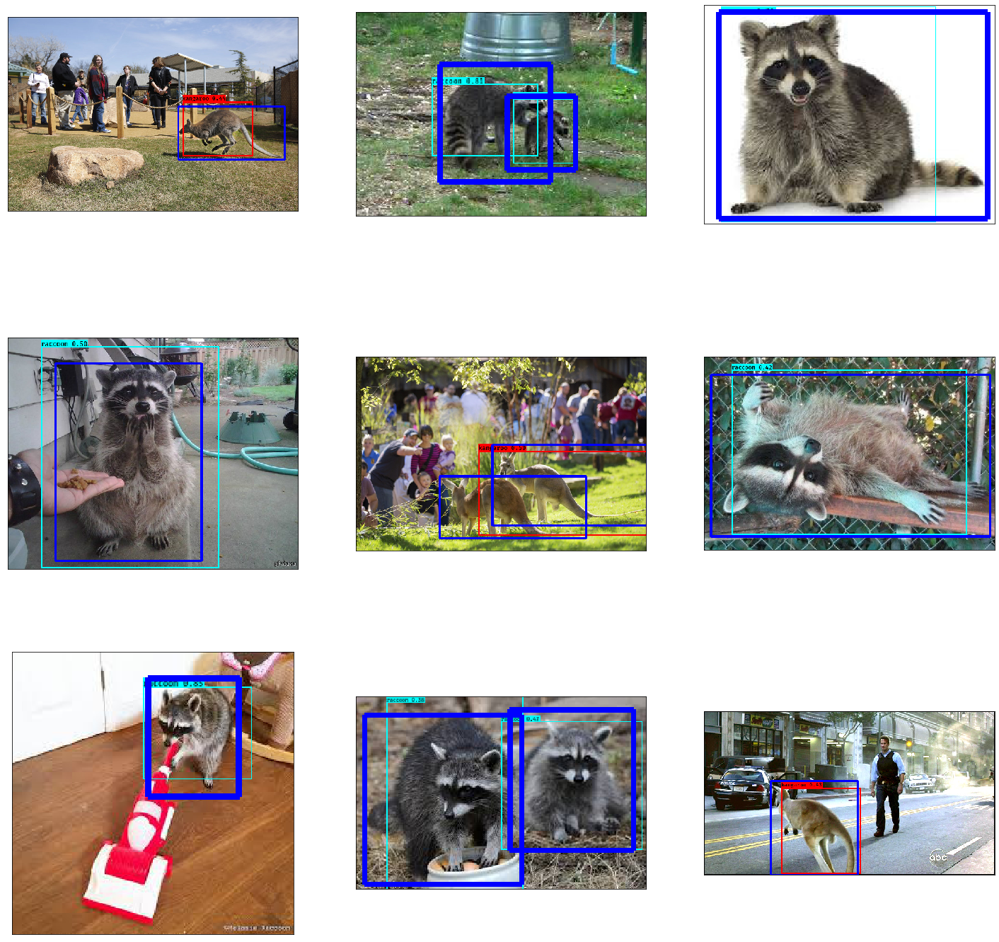

In [32]:
fig = plt.figure(figsize=(25,25))
for i in range(9):
    line = train_lines[i].split()
    image = Image.open(line[0])
    image = image.convert('RGB')
    tiny_yolo_image,out_boxes,out_scores,out_classes = tiny_yolo.detect_image(image)
    boxs = np.array([np.array(list(map(int,boxs.split(',')))) for boxs in line[1:]])
    draw = ImageDraw.Draw(tiny_yolo_image)
    for box in boxs:
        top, left, bottom, right,label = box
        draw.line(((top,left),(top,right),(bottom,right),(bottom,left),(top,left)), fill="blue", width=5)
    ax = fig.add_subplot(3, 3, i + 1, xticks=[], yticks=[])
    plt.imshow(tiny_yolo_image)
    for box in out_boxes:
        max_iou = 0
        for ground_truth in test_lines[0].split()[1:]:
            ground_truth = [int(i) for i in ground_truth.split(',')]
            iou = compute_iou(ground_truth[:-1],box)
            if(max_iou<iou):
                max_iou = iou
        print("IOU :" , max_iou*100)

### 測試集辨識結果

(416, 416, 3)
Found 1 boxes for img
raccoon 0.60 (105, 55) (498, 302)
IOU : 55.69428679530836
(416, 416, 3)
Found 1 boxes for img
raccoon 0.95 (148, 0) (434, 318)
IOU : 56.90885501135258
(416, 416, 3)
Found 1 boxes for img
raccoon 0.60 (41, 14) (223, 177)
IOU : 18.87510339123242
(416, 416, 3)
Found 1 boxes for img
raccoon 0.42 (35, 56) (225, 150)
IOU : 11.42329961188522
(416, 416, 3)
Found 1 boxes for img
raccoon 0.54 (128, 0) (604, 395)
IOU : 43.23954451807722
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 1 boxes for img
raccoon 0.64 (252, 122) (664, 492)
IOU : 19.174284803784175
(416, 416, 3)
Found 0 boxes for img


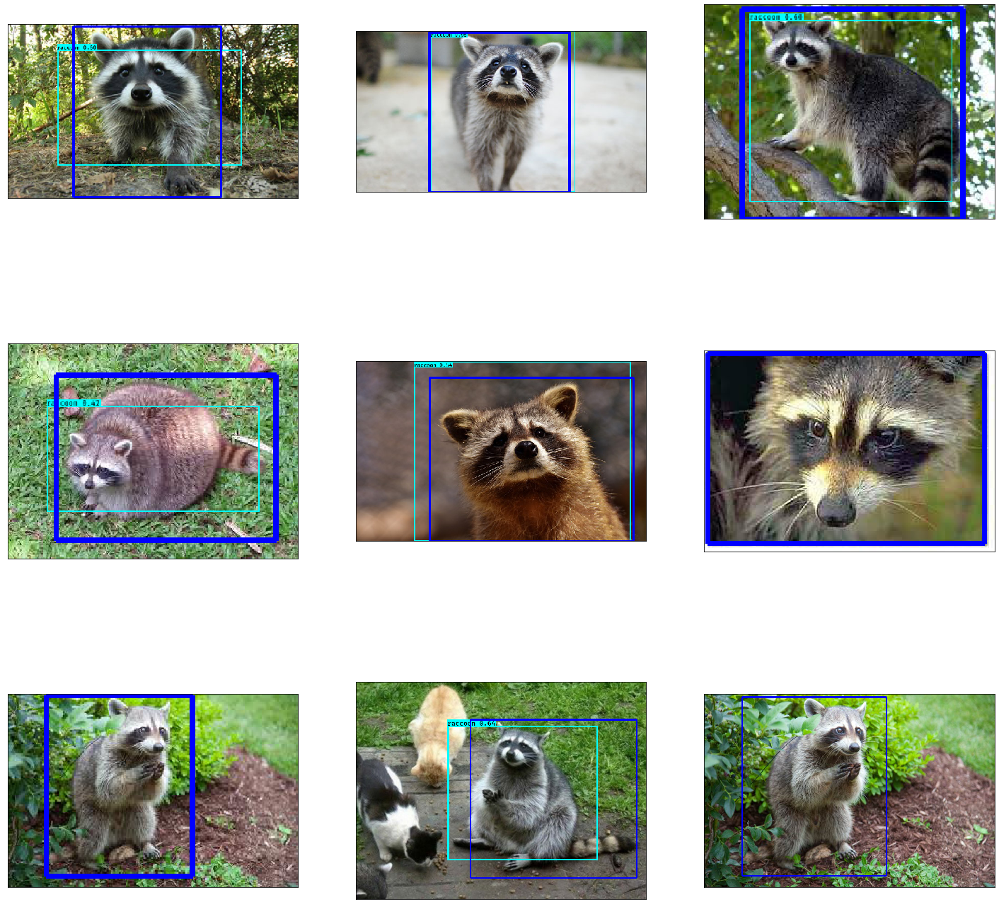

In [31]:
fig = plt.figure(figsize=(25,25))
for i in range(9):
    line = val_lines[i].split()
    image = Image.open(line[0])
    image = image.convert('RGB')
    tiny_yolo_image,out_boxes,out_scores,out_classes = tiny_yolo.detect_image(image)
    boxs = np.array([np.array(list(map(int,boxs.split(',')))) for boxs in line[1:]])
    draw = ImageDraw.Draw(tiny_yolo_image)
    for box in boxs:
        top, left, bottom, right,label = box
        draw.line(((top,left),(top,right),(bottom,right),(bottom,left),(top,left)), fill="blue", width=5)
    ax = fig.add_subplot(3, 3, i + 1, xticks=[], yticks=[])
    plt.imshow(tiny_yolo_image)
    for box in out_boxes:
        max_iou = 0
        for ground_truth in test_lines[0].split()[1:]:
            ground_truth = [int(i) for i in ground_truth.split(',')]
            iou = compute_iou(ground_truth[:-1],box)
            if(max_iou<iou):
                max_iou = iou
        print("IOU :" , max_iou*100)

### 測試集辨識結果

(416, 416, 3)
Found 1 boxes for img
raccoon 0.66 (23, 19) (313, 409)
IOU : 54.807889870556814
(416, 416, 3)
Found 1 boxes for img
kangaroo 0.74 (311, 45) (529, 286)
IOU : 22.844002878758623
(416, 416, 3)
Found 1 boxes for img
raccoon 0.82 (21, 24) (242, 138)
IOU : 16.243557930902845
(416, 416, 3)
Found 1 boxes for img
raccoon 0.78 (116, 26) (547, 314)
IOU : 57.42050061991086
(416, 416, 3)
Found 1 boxes for img
kangaroo 0.46 (514, 240) (962, 613)
IOU : 0
(416, 416, 3)
Found 1 boxes for img
kangaroo 0.45 (163, 71) (505, 479)
IOU : 40.71124212276674
(416, 416, 3)
Found 1 boxes for img
raccoon 0.33 (6, 30) (192, 287)
IOU : 30.482506288589068
(416, 416, 3)
Found 1 boxes for img
kangaroo 0.38 (93, 82) (533, 397)
IOU : 52.01316477499923
(416, 416, 3)
Found 0 boxes for img


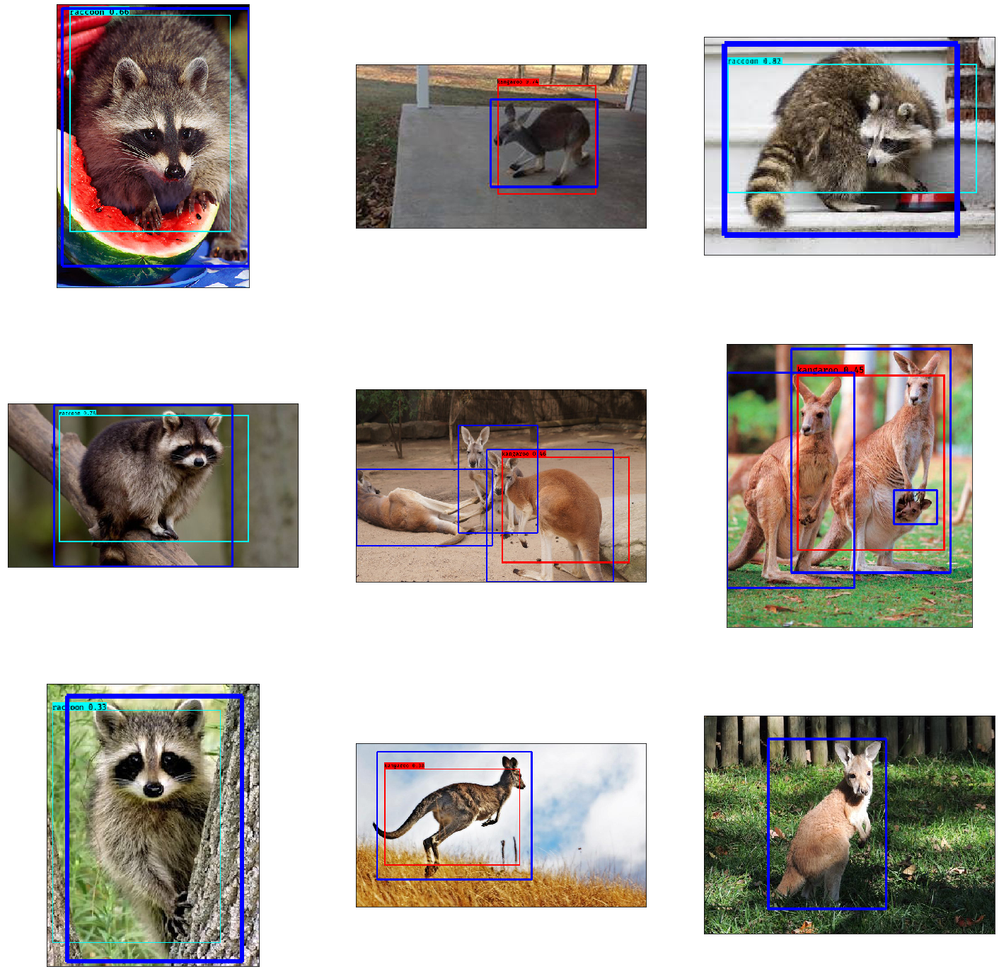

In [27]:
fig = plt.figure(figsize=(25,25))
for i in range(9):
    line = test_lines[i].split()
    image = Image.open(line[0])
    image = image.convert('RGB')
    tiny_yolo_image,out_boxes,out_scores,out_classes = tiny_yolo.detect_image(image)
    boxs = np.array([np.array(list(map(int,boxs.split(',')))) for boxs in line[1:]])
    draw = ImageDraw.Draw(tiny_yolo_image)
    for box in boxs:
        top, left, bottom, right,label = box
        draw.line(((top,left),(top,right),(bottom,right),(bottom,left),(top,left)), fill="blue", width=5)
    ax = fig.add_subplot(3, 3, i + 1, xticks=[], yticks=[])
    plt.imshow(tiny_yolo_image)
    for box in out_boxes:
        max_iou = 0
        for ground_truth in test_lines[0].split()[1:]:
            ground_truth = [int(i) for i in ground_truth.split(',')]
            iou = compute_iou(ground_truth[:-1],box)
            if(max_iou<iou):
                max_iou = iou
        print("IOU :" , max_iou*100)    

## video detector

In [28]:
def video_detect(video_path, output_path):
    import cv2
    import numpy as np
    from PIL import Image
    import timeit

    starttime = timeit.default_timer()
    cap = cv2.VideoCapture(video_path)

    # 使用 XVID 編碼
    fourcc = cv2.VideoWriter_fourcc(*'XVID')

    # 建立 VideoWriter 物件，輸出影片至 output.avi , FPS 值為 30.0，解析度為 1280*720
    out = cv2.VideoWriter(output_path, fourcc, 30.0, (1280, 720))

    k = 0
    while(cap.isOpened()):
        ret, frame = cap.read()
        if ret == True:
            # 寫入影格
            image = Image.fromarray(frame)
            image,out_boxes,out_scores,out_classes = tiny_yolo.detect_image(image)
            image = np.asarray(image)
            out.write(image)
            k += 1
        else:
            break
        
    # 釋放所有資源
    cap.release()
    out.release()
    print('共耗時:',round((timeit.default_timer() - starttime), 2), '秒，FPS:', round(k/(timeit.default_timer() - starttime), 2))

In [29]:
video_path = 'Data/video/Kangaroo.mp4'
output_path = 'Data/video/Kangaroo-yolov3-tiny.mp4'
video_detect(video_path=video_path, output_path=output_path)

(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes 

(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 1 boxes for img
raccoon 0.42 (489, 108) (992, 610)
(416, 416, 3)
Found 1 boxes for img
raccoon 0.46 (535, 96) (943, 636)
(416, 416, 3)
Found 1 boxes for img
raccoon 0.45 (534, 97) (944, 636)
(416, 416, 3)
Found 1 boxes for img
raccoon 0.43 (563, 109) (911, 616)
(416, 416, 3)
Found 1 boxes for img
raccoon 0.31 (566, 63) (903, 671)
(416, 416, 3)
Found 1 boxes for img
raccoon 0.46 (572, 81) (894, 659)
(416, 416, 3)
Found 1 boxes for img
raccoon 0.51 (553, 86) (911, 643)
(416, 416, 3)
Found 1 boxes for img
raccoon 0.50 (553, 89) (911, 642)
(416, 416, 3)
Found 2 boxes for img
kangaroo 0.33 (554, 128) (918, 609)
raccoon 0.38 (554, 128) (918, 609)
(416, 416, 3)
Found 1 boxes for img
kangaroo 0.59 (566, 52) (916, 681)
(416, 416, 3)
Found 1 boxes for img
kangaroo 0.51 (568, 81) (896, 657)
(416, 416, 3)
Found 1 boxes for img
kangaroo 

(416, 416, 3)
Found 1 boxes for img
kangaroo 0.52 (683, 453) (968, 649)
(416, 416, 3)
Found 1 boxes for img
kangaroo 0.55 (685, 450) (959, 648)
(416, 416, 3)
Found 1 boxes for img
kangaroo 0.55 (679, 455) (967, 645)
(416, 416, 3)
Found 1 boxes for img
kangaroo 0.51 (676, 455) (967, 645)
(416, 416, 3)
Found 2 boxes for img
kangaroo 0.36 (835, 202) (1047, 509)
kangaroo 0.55 (678, 452) (965, 653)
(416, 416, 3)
Found 2 boxes for img
kangaroo 0.38 (825, 206) (1056, 506)
kangaroo 0.48 (672, 456) (968, 648)
(416, 416, 3)
Found 3 boxes for img
kangaroo 0.30 (395, 373) (856, 720)
kangaroo 0.32 (820, 196) (1065, 516)
kangaroo 0.52 (668, 455) (971, 655)
(416, 416, 3)
Found 1 boxes for img
kangaroo 0.52 (666, 457) (968, 651)
(416, 416, 3)
Found 2 boxes for img
kangaroo 0.39 (409, 380) (859, 720)
kangaroo 0.55 (670, 451) (977, 657)
(416, 416, 3)
Found 2 boxes for img
kangaroo 0.42 (429, 394) (847, 720)
kangaroo 0.55 (660, 437) (982, 669)
(416, 416, 3)
Found 2 boxes for img
kangaroo 0.37 (423, 370) 

(416, 416, 3)
Found 1 boxes for img
kangaroo 0.48 (418, 430) (848, 688)
(416, 416, 3)
Found 1 boxes for img
kangaroo 0.41 (376, 448) (903, 672)
(416, 416, 3)
Found 1 boxes for img
kangaroo 0.35 (368, 445) (908, 675)
(416, 416, 3)
Found 1 boxes for img
kangaroo 0.33 (388, 449) (888, 667)
(416, 416, 3)
Found 1 boxes for img
kangaroo 0.40 (442, 460) (846, 657)
(416, 416, 3)
Found 2 boxes for img
kangaroo 0.37 (619, 266) (868, 461)
kangaroo 0.41 (441, 463) (851, 668)
(416, 416, 3)
Found 1 boxes for img
kangaroo 0.31 (441, 481) (870, 654)
(416, 416, 3)
Found 1 boxes for img
kangaroo 0.31 (441, 481) (870, 654)
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 1 boxes for img
kangaroo 0.37 (467, 239) (983, 643)
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 1 boxes for img
kangaroo 0.35 (490, 250) (968, 655)
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes 

Found 2 boxes for img
kangaroo 0.50 (328, 349) (717, 583)
kangaroo 0.59 (778, 338) (1058, 562)
(416, 416, 3)
Found 2 boxes for img
kangaroo 0.51 (308, 309) (575, 630)
kangaroo 0.58 (777, 345) (1046, 567)
(416, 416, 3)
Found 2 boxes for img
kangaroo 0.47 (675, 299) (1012, 627)
kangaroo 0.57 (274, 361) (754, 603)
(416, 416, 3)
Found 2 boxes for img
kangaroo 0.45 (673, 298) (1012, 631)
kangaroo 0.59 (266, 359) (760, 604)
(416, 416, 3)
Found 3 boxes for img
kangaroo 0.33 (703, 407) (1016, 592)
kangaroo 0.43 (652, 311) (998, 661)
kangaroo 0.47 (261, 304) (778, 626)
(416, 416, 3)
Found 2 boxes for img
kangaroo 0.52 (627, 313) (1023, 678)
kangaroo 0.75 (229, 326) (674, 597)
(416, 416, 3)
Found 3 boxes for img
kangaroo 0.57 (763, 292) (938, 674)
kangaroo 0.68 (94, 336) (781, 583)
kangaroo 0.82 (647, 334) (1018, 601)
(416, 416, 3)
Found 1 boxes for img
kangaroo 0.65 (649, 315) (1006, 578)
(416, 416, 3)
Found 1 boxes for img
kangaroo 0.65 (649, 315) (1008, 577)
(416, 416, 3)
Found 1 boxes for im

Found 1 boxes for img
kangaroo 0.58 (651, 124) (1063, 586)
(416, 416, 3)
Found 1 boxes for img
kangaroo 0.55 (692, 117) (1018, 596)
(416, 416, 3)
Found 1 boxes for img
kangaroo 0.56 (660, 120) (1054, 593)
(416, 416, 3)
Found 1 boxes for img
kangaroo 0.45 (664, 111) (1053, 601)
(416, 416, 3)
Found 1 boxes for img
kangaroo 0.32 (709, 143) (1099, 563)
(416, 416, 3)
Found 1 boxes for img
kangaroo 0.33 (707, 142) (1101, 563)
(416, 416, 3)
Found 1 boxes for img
kangaroo 0.32 (698, 156) (1112, 553)
(416, 416, 3)
Found 1 boxes for img
kangaroo 0.34 (689, 153) (1132, 554)
(416, 416, 3)
Found 1 boxes for img
kangaroo 0.36 (683, 132) (1138, 571)
(416, 416, 3)
Found 1 boxes for img
kangaroo 0.34 (699, 140) (1113, 565)
(416, 416, 3)
Found 1 boxes for img
kangaroo 0.34 (699, 140) (1113, 565)
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 1 boxes for img
kangaroo 0.37 (720, 153) (1104, 553)
(416, 416, 3)
Found 1 boxes fo

Found 1 boxes for img
kangaroo 0.67 (868, 198) (1186, 476)
(416, 416, 3)
Found 1 boxes for img
kangaroo 0.63 (840, 174) (1198, 514)
(416, 416, 3)
Found 1 boxes for img
kangaroo 0.63 (843, 167) (1197, 525)
(416, 416, 3)
Found 1 boxes for img
kangaroo 0.71 (844, 237) (1202, 490)
(416, 416, 3)
Found 1 boxes for img
kangaroo 0.37 (819, 241) (1219, 509)
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(

(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes 

(416, 416, 3)
Found 2 boxes for img
kangaroo 0.51 (297, 179) (595, 568)
kangaroo 0.74 (400, 242) (889, 671)
(416, 416, 3)
Found 2 boxes for img
kangaroo 0.45 (290, 163) (595, 568)
kangaroo 0.68 (405, 257) (882, 665)
(416, 416, 3)
Found 2 boxes for img
kangaroo 0.45 (293, 162) (592, 574)
kangaroo 0.71 (409, 244) (876, 677)
(416, 416, 3)
Found 2 boxes for img
kangaroo 0.41 (313, 185) (560, 563)
kangaroo 0.78 (432, 258) (855, 669)
(416, 416, 3)
Found 2 boxes for img
kangaroo 0.73 (454, 249) (828, 666)
raccoon 0.40 (282, 202) (587, 544)
(416, 416, 3)
Found 2 boxes for img
kangaroo 0.48 (278, 210) (581, 526)
kangaroo 0.77 (450, 257) (837, 663)
(416, 416, 3)
Found 4 boxes for img
kangaroo 0.31 (289, 219) (558, 516)
kangaroo 0.70 (410, 241) (879, 662)
raccoon 0.37 (289, 219) (558, 516)
raccoon 0.44 (225, 113) (616, 592)
(416, 416, 3)
Found 4 boxes for img
kangaroo 0.36 (289, 220) (557, 515)
kangaroo 0.71 (423, 238) (866, 666)
raccoon 0.33 (289, 220) (557, 515)
raccoon 0.44 (233, 116) (609, 59

(416, 416, 3)
Found 1 boxes for img
kangaroo 0.31 (325, 312) (605, 586)
(416, 416, 3)
Found 2 boxes for img
kangaroo 0.34 (341, 301) (594, 591)
kangaroo 0.37 (511, 130) (1115, 611)
(416, 416, 3)
Found 1 boxes for img
kangaroo 0.44 (314, 276) (615, 612)
(416, 416, 3)
Found 1 boxes for img
kangaroo 0.37 (312, 278) (616, 612)
(416, 416, 3)
Found 2 boxes for img
kangaroo 0.34 (426, 275) (613, 623)
kangaroo 0.66 (500, 91) (1001, 616)
(416, 416, 3)
Found 2 boxes for img
kangaroo 0.34 (419, 272) (607, 631)
kangaroo 0.68 (516, 95) (986, 614)
(416, 416, 3)
Found 1 boxes for img
kangaroo 0.68 (568, 107) (928, 611)
(416, 416, 3)
Found 1 boxes for img
kangaroo 0.65 (533, 87) (972, 624)
(416, 416, 3)
Found 1 boxes for img
kangaroo 0.64 (606, 87) (1010, 631)
(416, 416, 3)
Found 1 boxes for img
kangaroo 0.53 (499, 142) (990, 576)
(416, 416, 3)
Found 1 boxes for img
kangaroo 0.51 (495, 142) (995, 573)
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes f

(416, 416, 3)
Found 1 boxes for img
kangaroo 0.46 (691, 338) (951, 574)
(416, 416, 3)
Found 1 boxes for img
kangaroo 0.65 (706, 337) (940, 579)
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes 

In [30]:
video_path = 'Data/video/Raccoon.mp4'
output_path = 'Data/video/Raccoon-yolov3-tiny.mp4'
video_detect(video_path=video_path, output_path=output_path)

(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes 

(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes 

Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 

(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes 

Found 1 boxes for img
raccoon 0.35 (305, 91) (788, 487)
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 1 boxes for img
raccoon 0.36 (307, 64) (810, 517)
(416, 416, 3)
Found 1 boxes for img
raccoon 0.32 (206, 101) (899, 574)
(416, 416, 3)
Found 1 boxes for img
raccoon 0.33 (247, 90) (857, 600)
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 1 boxes for img
raccoon 0.40 (320, 0) (816, 593)
(416, 416, 3)
Found 1 boxes for img
raccoon 0.34 (333, 0) (788, 568)
(416, 416, 3)
Found 1 boxes for img
raccoon 0.38 (316, 

(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 1 boxes for img
raccoon 0.39 (398, 90) (747, 594)
(416, 416, 3)
Found 1 boxes for img
raccoon 0.31 (404, 67) (745, 618)
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for 

(416, 416, 3)
Found 1 boxes for img
raccoon 0.89 (369, 95) (895, 608)
(416, 416, 3)
Found 1 boxes for img
raccoon 0.60 (250, 154) (1016, 540)
(416, 416, 3)
Found 1 boxes for img
raccoon 0.73 (327, 154) (919, 528)
(416, 416, 3)
Found 1 boxes for img
raccoon 0.76 (353, 140) (911, 551)
(416, 416, 3)
Found 1 boxes for img
raccoon 0.76 (337, 152) (918, 543)
(416, 416, 3)
Found 1 boxes for img
raccoon 0.83 (296, 144) (965, 558)
(416, 416, 3)
Found 1 boxes for img
raccoon 0.81 (357, 136) (893, 557)
(416, 416, 3)
Found 1 boxes for img
raccoon 0.79 (369, 148) (887, 538)
(416, 416, 3)
Found 1 boxes for img
raccoon 0.85 (388, 164) (860, 537)
(416, 416, 3)
Found 1 boxes for img
raccoon 0.83 (370, 165) (875, 529)
(416, 416, 3)
Found 1 boxes for img
raccoon 0.80 (355, 189) (887, 513)
(416, 416, 3)
Found 1 boxes for img
raccoon 0.72 (345, 182) (893, 522)
(416, 416, 3)
Found 1 boxes for img
raccoon 0.80 (363, 180) (880, 530)
(416, 416, 3)
Found 1 boxes for img
raccoon 0.72 (323, 159) (921, 536)
(416, 

Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 

(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 1 boxes for img
raccoon 0.30 (188, 332) (533, 639)
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes f

Found 1 boxes for img
raccoon 0.33 (140, 233) (552, 720)
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 1 boxes for img
kangaroo 0.30 (101, 341) (564, 689)
(416, 416, 3)
Found 1 boxes for img
kangaroo 0.38 (106, 336) (569, 695)
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 1 boxes for img
kangaroo 0.41 (423, 270) (670, 623)
(416, 416, 3)
Found 1 boxes for img
kangaroo 0.31 (438, 308) (649, 594)
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 0 boxes for img
(416, 416, 3)
Found 1 boxes for img
kangaroo 0.31 (764, 277) (937, 637)
共耗時: 77.47 秒，FPS: 23.22
